In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv('macroeconomic.csv')

In [3]:
columns_to_keep = ['Title', 'Publication Year', 'Publication Type', 'Source Title', 'Abstract',
                   'Fields of Study', 'Citing Patents Count', 'Citing Works Count']
df = df[columns_to_keep]
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3944 entries, 0 to 3943
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Title                 3944 non-null   object 
 1   Publication Year      3937 non-null   float64
 2   Publication Type      3944 non-null   object 
 3   Source Title          3944 non-null   object 
 4   Abstract              3506 non-null   object 
 5   Fields of Study       3628 non-null   object 
 6   Citing Patents Count  3944 non-null   int64  
 7   Citing Works Count    3944 non-null   int64  
dtypes: float64(1), int64(2), object(5)
memory usage: 246.6+ KB


In [4]:
df = df.dropna()
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3322 entries, 0 to 3939
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Title                 3322 non-null   object 
 1   Publication Year      3322 non-null   float64
 2   Publication Type      3322 non-null   object 
 3   Source Title          3322 non-null   object 
 4   Abstract              3322 non-null   object 
 5   Fields of Study       3322 non-null   object 
 6   Citing Patents Count  3322 non-null   int64  
 7   Citing Works Count    3322 non-null   int64  
dtypes: float64(1), int64(2), object(5)
memory usage: 233.6+ KB


In [5]:
#df = df[df["Citing Patents Count"] == 0]

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3322 entries, 0 to 3939
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Title                 3322 non-null   object 
 1   Publication Year      3322 non-null   float64
 2   Publication Type      3322 non-null   object 
 3   Source Title          3322 non-null   object 
 4   Abstract              3322 non-null   object 
 5   Fields of Study       3322 non-null   object 
 6   Citing Patents Count  3322 non-null   int64  
 7   Citing Works Count    3322 non-null   int64  
dtypes: float64(1), int64(2), object(5)
memory usage: 233.6+ KB


In [7]:
df["Publication Year"] = df["Publication Year"].values.astype(int)
# Introducing temporal ordering
#df["Publication Year"] = pd.to_datetime(df["Publication Year"])
df = df.sort_values(by="Publication Year")

In [8]:
df = df.drop(df[(df['Abstract'] == 'n/') | (df['Abstract'] == "")].index)

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3322 entries, 1134 to 1914
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Title                 3322 non-null   object
 1   Publication Year      3322 non-null   int32 
 2   Publication Type      3322 non-null   object
 3   Source Title          3322 non-null   object
 4   Abstract              3322 non-null   object
 5   Fields of Study       3322 non-null   object
 6   Citing Patents Count  3322 non-null   int64 
 7   Citing Works Count    3322 non-null   int64 
dtypes: int32(1), int64(2), object(5)
memory usage: 380.6+ KB


In [10]:
pd.set_option('display.max_rows', df.shape[0]+1)
pd.set_option('display.max_columns',df.shape[1]+1)
pd.set_option('display.width', 1000)
pd.set_option('display.max_colwidth', None)

<AxesSubplot:xlabel='Publication Year'>

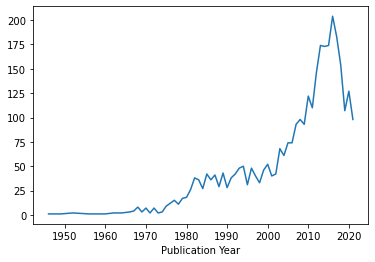

In [11]:
df.groupby('Publication Year').count()['Title'].plot()

<AxesSubplot:xlabel='Publication Year'>

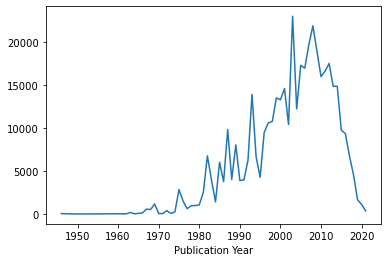

In [12]:
df.groupby('Publication Year').sum()['Citing Works Count'].plot()

In [13]:
import heapq
import re # regular expressions
import nltk
import string
nltk.download('punkt')
nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('english')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\carus\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\carus\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [14]:
def preprocess(text):
    formatted_text = text.lower()
    tokens = []
    for token in nltk.word_tokenize(formatted_text):
        tokens.append(token)
    
    #print(tokens)
    tokens = [word for word in tokens if word not in stopwords and word not in string.punctuation]
    formatted_text = ' '.join(element for element in tokens)
    return formatted_text

In [15]:
df["Abstract"] = df["Abstract"].apply(preprocess)

In [16]:
counts = df.groupby('Publication Year').count()['Title'].values
place_holder = [None]*(len(counts)+1)
place_holder[0] = 0
for i in range(1,len(counts)+1):
    place_holder[i] = place_holder[i-1] + counts[i-1]

In [17]:
len(counts)

64

In [18]:
len(df['Publication Year'].unique())

64

In [19]:
df = df.drop(df[(df['Abstract'] == 'n/') | (df['Abstract'] == "")].index)

In [20]:
df[(df['Abstract'] == 'n/') | (df['Abstract'] == "")].index

Int64Index([], dtype='int64')

In [21]:
df['Publication Year'].unique()

array([1946, 1949, 1952, 1956, 1960, 1962, 1963, 1964, 1966, 1967, 1968,
       1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979,
       1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990,
       1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001,
       2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012,
       2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021])

In [22]:
df['Publication Year'].value_counts() 

2016    204
2017    183
2015    174
2013    174
2014    173
2018    154
2012    146
2020    127
2010    122
2011    110
2019    107
2008     98
2021     98
2007     93
2009     93
2005     74
2006     74
2003     68
2004     61
2000     52
1994     50
1996     48
1993     48
1999     46
1989     43
2002     42
1985     42
1992     42
1987     41
1997     40
2001     40
1982     38
1991     38
1986     36
1983     36
1998     33
1995     31
1988     29
1990     28
1984     27
1981     26
1980     18
1979     17
1977     15
1976     12
1978     11
1975      9
1968      8
1972      7
1970      7
1967      4
1969      3
1966      3
1974      3
1962      2
1964      2
1973      2
1963      2
1971      2
1952      2
1956      1
1949      1
1960      1
1946      1
Name: Publication Year, dtype: int64

In [23]:
interesting_years = [1952, 1962, 1963, 1964, 1966, 1967, 1968,
       1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979,
       1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990,
       1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001,
       2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012,
       2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021]
interesting_years.sort()

In [50]:
recent_years = [2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008,
               2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020]
df_recent = df[df['Publication Year'].isin(recent_years)]

In [51]:
percentage_high = 0.95
percentage_low = 0.015 # 1% or 1.5% is probably better

In [52]:
# Applying TFIDF to titles
#You can still get n-grams here
vectorizer_abstracts = TfidfVectorizer(ngram_range = (2, 2), max_df = percentage_high, min_df = percentage_low)
abstracts_tfidf = vectorizer_abstracts.fit_transform(df_recent["Abstract"])
scores = (abstracts_tfidf.toarray())
#print("\n\nScores : \n", scores)

In [53]:
tf_idf_abstracts = pd.DataFrame(data=abstracts_tfidf.toarray(),columns=vectorizer_abstracts.get_feature_names())
tf_idf_abstracts.shape

(2369, 98)

In [54]:
tf_idf_abstracts.columns

Index(['abstract paper', 'abstract study', 'across countries', 'allows us', 'also find', 'asset prices', 'asset pricing', 'business cycle', 'business cycles', 'central bank', 'central banks', 'country specific', 'cross country', 'cross section', 'cross sectional', 'current account', 'data set', 'developing countries', 'dsge model', 'dynamic stochastic', 'economic activity', 'economic growth', 'emerging markets', 'empirical evidence', 'empirical results', 'equilibrium model', 'et al', 'euro area', 'exchange rate', 'exchange rates', 'federal reserve', 'financial crisis', 'financial markets', 'find evidence', 'firm level', 'fiscal policy', 'foreign exchange', 'forward looking', 'gdp growth', 'general equilibrium', 'global financial', 'government spending', 'great recession', 'growth model', 'growth rate', 'human capital', 'important role', 'interest rate', 'interest rates', 'international trade', 'key macroeconomic', 'labor market', 'labor supply', 'long run', 'long term',
       'macroec



Most relevant bi-grams 
                           term        rank
65               paper studies  118.461294
28               fiscal policy  115.452699
0               abstract paper   91.567410
53     macroeconomic variables   87.108501
7               business cycle   85.960206
47  macroeconomic fluctuations   70.176758
39         international trade   67.190947
21           equilibrium model   64.670837
64                 paper shows   60.768060
48         macroeconomic model   53.471278
27               find evidence   50.500766
51        macroeconomic policy   50.201320
31         general equilibrium   45.170783
35                 growth rate   44.923140
25            financial crisis   43.294202
29            foreign exchange   43.215110
68       rational expectations   40.088614
45    macroeconomic conditions   40.060949
54             monetary policy   39.770947
23               exchange rate   39.436022
9                 central bank   39.166106
32            global financ

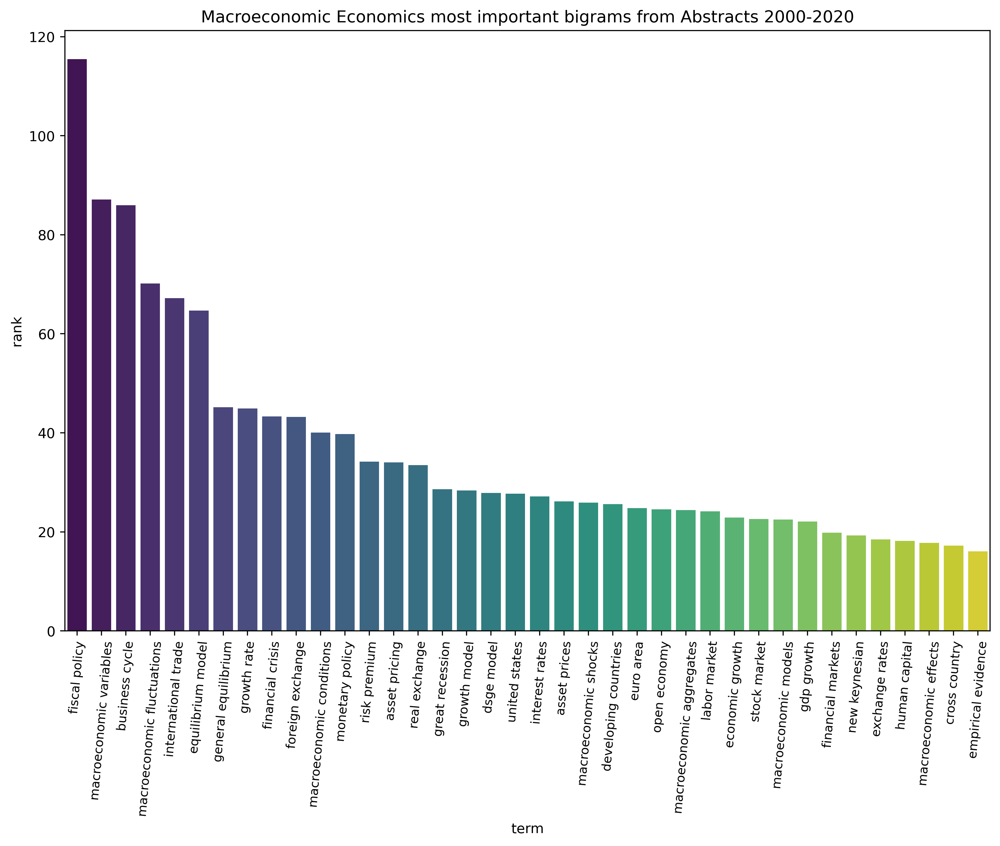

In [55]:
 # Getting top ranking features
sums = abstracts_tfidf.sum(axis = 0)
data1 = []
for col, term in enumerate(features_abstracts):
    data1.append((term, sums[0, col]))
ranking = pd.DataFrame(data1, columns = ['term', 'rank'])
words = (ranking.sort_values('rank', ascending = False))
print("\n\nMost relevant bi-grams \n", words.head(50))
plt.figure(figsize=(12,8), dpi=400)
sns.barplot(x="term", y="rank", data=ranking.loc[ranking['term'].isin(['asset prices', 'asset pricing', 
'business cycle', 'central banks', 'country specific', 'cross country', 'developing countries', 'dsge model',
'economic growth', 'emerging markets', 'empirical evidence', 'equilibrium model', 'euro area', 'exchange rates',
'federal reserve', 'financial crisis', 'financial markets', 
'fiscal policy', 'foreign exchange','gdp growth', 'general equilibrium', 
'government spending', 'great recession', 'growth model', 'growth rate', 
'human capital', 'interest rates', 'international trade', 
'labor market', 'labor supply','macroeconomic aggregates', 'macroeconomic conditions', 
'macroeconomic effects', 'macroeconomic fluctuations',  
'macroeconomic models', 'macroeconomic shocks', 'macroeconomic variables', 
'monetary policy', 'monetary union', 'new keynesian', 'open economy', 'policy shocks', 'real exchange', 'real gdp', 
'risk premium','stock market', 'term structure','united states'])].sort_values('rank', ascending = False), palette = 'viridis')
plt.title("Macroeconomic Economics most important bigrams from Abstracts 2000-2020")
plt.xticks(fontsize=9, rotation=85);
plt.yticks(fontsize=10);

In [24]:
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
import scipy.sparse as sparse
import networkx as nx

In [25]:
percentage_high = 0.95
percentage_low = 0.015 # 1% or 1.5% is probably better

In [26]:
# Getting bigrams from abstracts
vectorizer_abstracts = CountVectorizer(ngram_range =(2, 2), max_df = percentage_high, min_df = percentage_low)
X_titles = vectorizer_abstracts.fit_transform(df["Abstract"]) 
features_abstracts = (vectorizer_abstracts.get_feature_names())
#print("\n\nX_titles : \n", X_titles.toarray())

In [27]:
# Applying TFIDF to titles
#You can still get n-grams here
vectorizer_abstracts = TfidfVectorizer(ngram_range = (2, 2), max_df = percentage_high, min_df = percentage_low)
abstracts_tfidf = vectorizer_abstracts.fit_transform(df["Abstract"])
scores = (abstracts_tfidf.toarray())
#print("\n\nScores : \n", scores)



Most relevant bi-grams 
                        term        rank
54          monetary policy  174.786515
23            exchange rate  167.065568
0            abstract paper  160.948971
42                 long run  129.102699
7            business cycle  118.587003
37            interest rate  100.551916
31      general equilibrium   98.240470
82            united states   94.359877
48      macroeconomic model   88.801525
53  macroeconomic variables   88.342846
38           interest rates   88.238543
18          economic growth   81.832275
74                short run   80.859144
79              time series   77.480558
24           exchange rates   70.197974
40             labor market   67.930584
56             open economy   66.234249
49     macroeconomic models   65.985122
28            fiscal policy   65.738479
19       empirical evidence   60.251962
21        equilibrium model   59.479044
22                euro area   58.445695
60           paper examines   58.337696
68    rationa

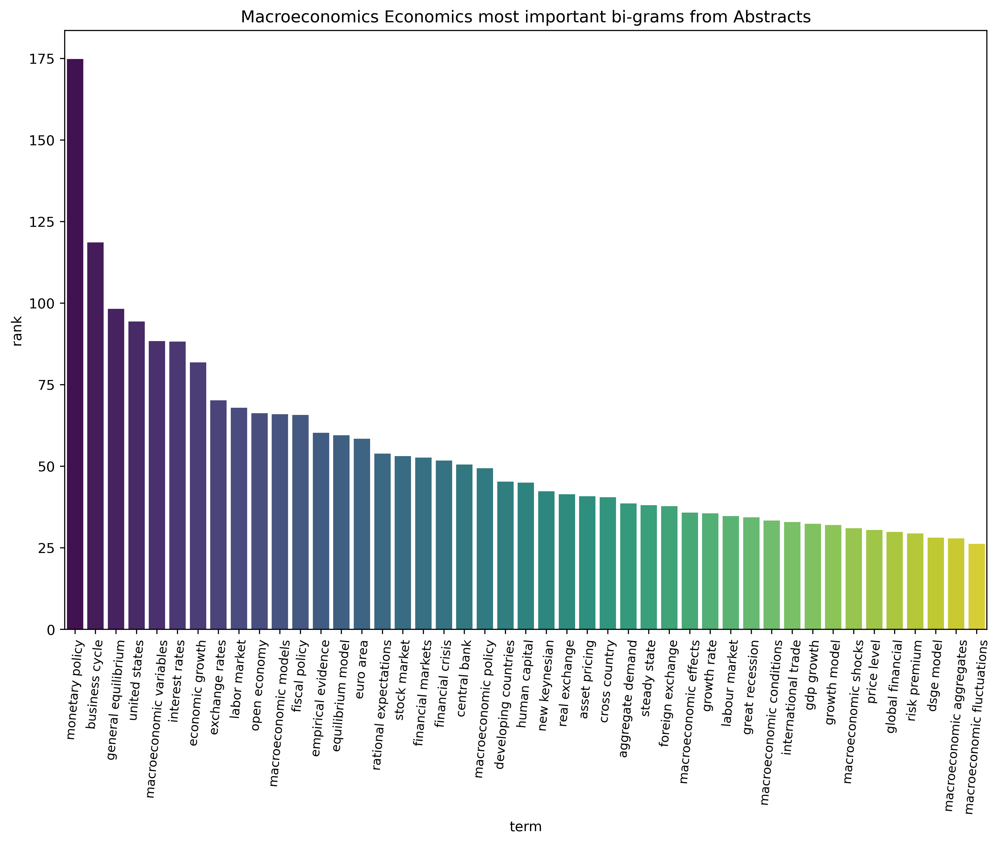

In [28]:
 # Getting top ranking features
sums = abstracts_tfidf.sum(axis = 0)
data1 = []
for col, term in enumerate(features_abstracts):
    data1.append((term, sums[0, col]))
ranking = pd.DataFrame(data1, columns = ['term', 'rank'])
words = (ranking.sort_values('rank', ascending = False))
print("\n\nMost relevant bi-grams \n", words.head(50))
plt.figure(figsize=(12,8), dpi=400)
sns.barplot(x="term", y="rank", data=ranking.loc[ranking['term'].isin(['aggregate demand','asset pricing',
       'business cycle', 'central bank',
       'cross country', 'developing countries',
       'dsge model', 'economic growth',
       'empirical evidence', 'equilibrium model',
       'euro area','exchange rates', 'financial crisis',
       'financial markets', 'fiscal policy',
       'foreign exchange', 'gdp growth', 'general equilibrium',
       'global financial', 'great recession', 'growth model',
       'growth rate', 'human capital', 'interest rates',
       'international trade', 'labor market', 'labour market','macroeconomic aggregates',
       'macroeconomic conditions', 'macroeconomic effects',
       'macroeconomic fluctuations',
       'macroeconomic models', 
       'macroeconomic policy', 'macroeconomic shocks',
       'macroeconomic variables', 'monetary policy', 'new keynesian',
       'open economy', 'price level', 'rational expectations', 'real exchange',
       'risk premium','steady state', 'stock market', 'united states'])].sort_values('rank', ascending = False), palette = 'viridis')
plt.title("Macroeconomics Economics most important bi-grams from Abstracts")
plt.xticks(fontsize=9, rotation=85);
plt.yticks(fontsize=10);

In [29]:
ranking['term'].unique()

array(['abstract paper', 'abstract study', 'across countries',
       'aggregate demand', 'also find', 'asset prices', 'asset pricing',
       'business cycle', 'business cycles', 'central bank',
       'cross country', 'cross section', 'cross sectional',
       'current account', 'data set', 'developing countries',
       'dsge model', 'economic activity', 'economic growth',
       'empirical evidence', 'empirical results', 'equilibrium model',
       'euro area', 'exchange rate', 'exchange rates', 'financial crisis',
       'financial markets', 'find evidence', 'fiscal policy',
       'foreign exchange', 'gdp growth', 'general equilibrium',
       'global financial', 'great recession', 'growth model',
       'growth rate', 'human capital', 'interest rate', 'interest rates',
       'international trade', 'labor market', 'labour market', 'long run',
       'long term', 'macroeconomic aggregates',
       'macroeconomic conditions', 'macroeconomic effects',
       'macroeconomic fluctuat

In [30]:
ranking.loc[ranking['term'].isin(['aggregate demand','asset pricing',
       'business cycle', 'central bank',
       'cross country', 'developing countries',
       'dsge model', 'economic growth',
       'empirical evidence', 'equilibrium model',
       'euro area','exchange rates', 'financial crisis',
       'financial markets', 'fiscal policy',
       'foreign exchange', 'gdp growth', 'general equilibrium',
       'global financial', 'great recession', 'growth model',
       'growth rate', 'human capital', 'interest rates',
       'international trade', 'labor market', 'labour market','macroeconomic aggregates',
       'macroeconomic conditions', 'macroeconomic effects',
       'macroeconomic fluctuations',
       'macroeconomic models', 
       'macroeconomic policy', 'macroeconomic shocks',
       'macroeconomic variables', 'monetary policy', 'new keynesian',
       'open economy', 'price level', 'rational expectations', 'real exchange',
       'risk premium','steady state', 'stock market', 'united states'])].sort_values('rank', ascending = False)

,term,rank
54,monetary policy,174.786515
7,business cycle,118.587003
31,general equilibrium,98.240470
82,united states,94.359877
53,macroeconomic variables,88.342846
38,interest rates,88.238543
18,economic growth,81.832275
24,exchange rates,70.197974
40,labor market,67.930584
56,open economy,66.234249


In [31]:
#tf_idf_abstracts = pd.DataFrame.sparse.from_spmatrix(abstracts_tfidf, columns=vectorizer_abstracts.get_feature_names())
tf_idf_abstracts = pd.DataFrame(data=abstracts_tfidf.toarray(),columns=vectorizer_abstracts.get_feature_names())
tf_idf_abstracts.shape

(3322, 84)

In [32]:
tf_idf_abstracts.columns

Index(['abstract paper', 'abstract study', 'across countries', 'aggregate demand', 'also find', 'asset prices', 'asset pricing', 'business cycle', 'business cycles', 'central bank', 'cross country', 'cross section', 'cross sectional', 'current account', 'data set', 'developing countries', 'dsge model', 'economic activity', 'economic growth', 'empirical evidence', 'empirical results', 'equilibrium model', 'euro area', 'exchange rate', 'exchange rates', 'financial crisis', 'financial markets', 'find evidence', 'fiscal policy', 'foreign exchange', 'gdp growth', 'general equilibrium', 'global financial', 'great recession', 'growth model', 'growth rate', 'human capital', 'interest rate', 'interest rates', 'international trade', 'labor market', 'labour market', 'long run', 'long term', 'macroeconomic aggregates', 'macroeconomic conditions', 'macroeconomic effects', 'macroeconomic fluctuations', 'macroeconomic model', 'macroeconomic models', 'macroeconomic policies', 'macroeconomic policy',
 

In [33]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaled_X = scaler.fit_transform(tf_idf_abstracts)

In [34]:
from sklearn.decomposition import PCA

In [35]:
explained_variance = []

for n in range(1,tf_idf_abstracts.shape[1]+1):
    pca = PCA(n_components=n)
    pca.fit(scaled_X)
    explained_variance.append(np.sum(pca.explained_variance_ratio_))

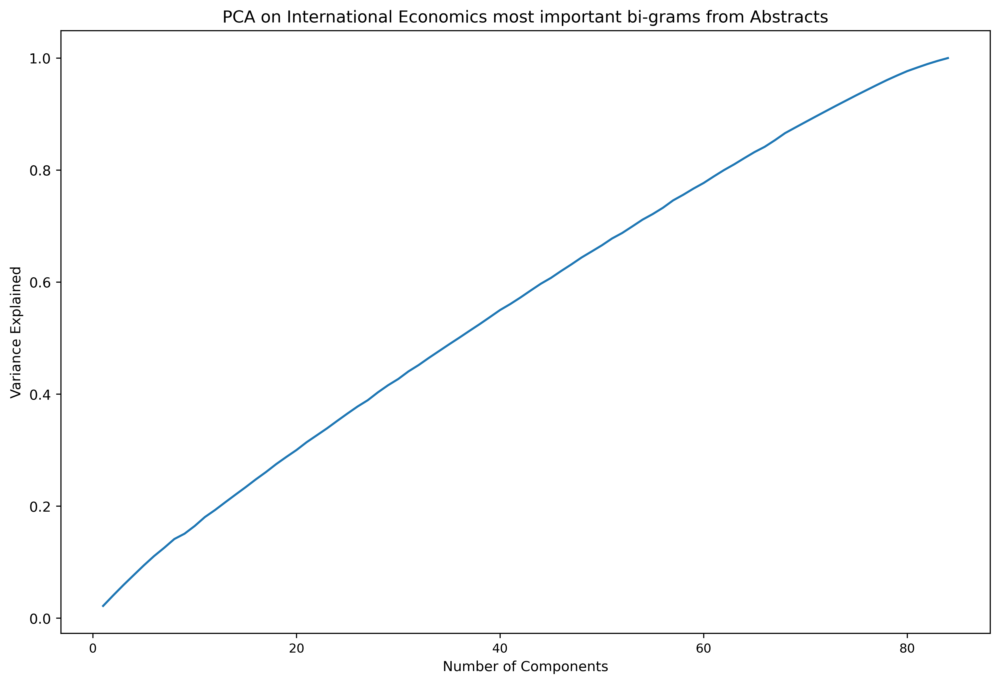

In [36]:
plt.figure(figsize=(12,8), dpi=400)
plt.plot(range(1,tf_idf_abstracts.shape[1]+1),explained_variance)
plt.title("PCA on International Economics most important bi-grams from Abstracts")
plt.xticks(fontsize=9);
plt.yticks(fontsize=10);
plt.xlabel("Number of Components")
plt.ylabel("Variance Explained");

In [37]:
interesting_columns = ['aggregate demand','asset pricing',
       'business cycle', 'central bank',
       'cross country', 'developing countries',
       'dsge model', 'economic growth',
       'empirical evidence', 'equilibrium model',
       'euro area','exchange rates', 'financial crisis',
       'financial markets', 'fiscal policy',
       'foreign exchange', 'gdp growth', 'general equilibrium',
       'global financial', 'great recession', 'growth model',
       'growth rate', 'human capital', 'interest rates',
       'international trade', 'labor market', 'labour market','macroeconomic aggregates',
       'macroeconomic conditions', 'macroeconomic effects',
       'macroeconomic fluctuations',
       'macroeconomic models', 
       'macroeconomic policy', 'macroeconomic shocks',
       'macroeconomic variables', 'monetary policy', 'new keynesian',
       'open economy', 'price level', 'rational expectations', 'real exchange',
       'risk premium','steady state', 'stock market', 'united states']

In [38]:
tf_idf_abstracts = tf_idf_abstracts[interesting_columns]
tf_idf_abstracts.shape

(3322, 45)

{'1': Text(-0.0022227060862221215, -0.06245176259252339, '1'),
 '2': Text(-0.33781258543193954, 0.47850290172528537, '2'),
 '3': Text(0.24840410607133262, 0.48597946860175956, '3'),
 '4': Text(0.572603522693295, 0.44149890460014785, '4'),
 '5': Text(0.09426064506625098, 0.27221562944887767, '5'),
 '6': Text(0.34899179641154726, -0.2266966141960745, '6'),
 '7': Text(0.23128088002944874, 0.10683298670993406, '7'),
 '8': Text(-0.3026630447425118, 0.14599177672938485, '8'),
 '9': Text(0.03327599046813291, 0.4229262149457203, '9'),
 '10': Text(0.4187418699508086, -0.023151173842191362, '10'),
 '45': Text(-0.26478785955358347, 0.2989019345262436, '45'),
 '11': Text(-0.11261181758354787, 0.12105239567757266, '11'),
 '12': Text(-0.01786968010428681, 0.21170747110416735, '12'),
 '13': Text(-0.07655630753842381, -0.1519217444266298, '13'),
 '14': Text(-0.015300210646601291, 0.7973275029475858, '14'),
 '15': Text(-0.29408577051152857, -0.17478020966317123, '15'),
 '16': Text(-0.40713184781543543,

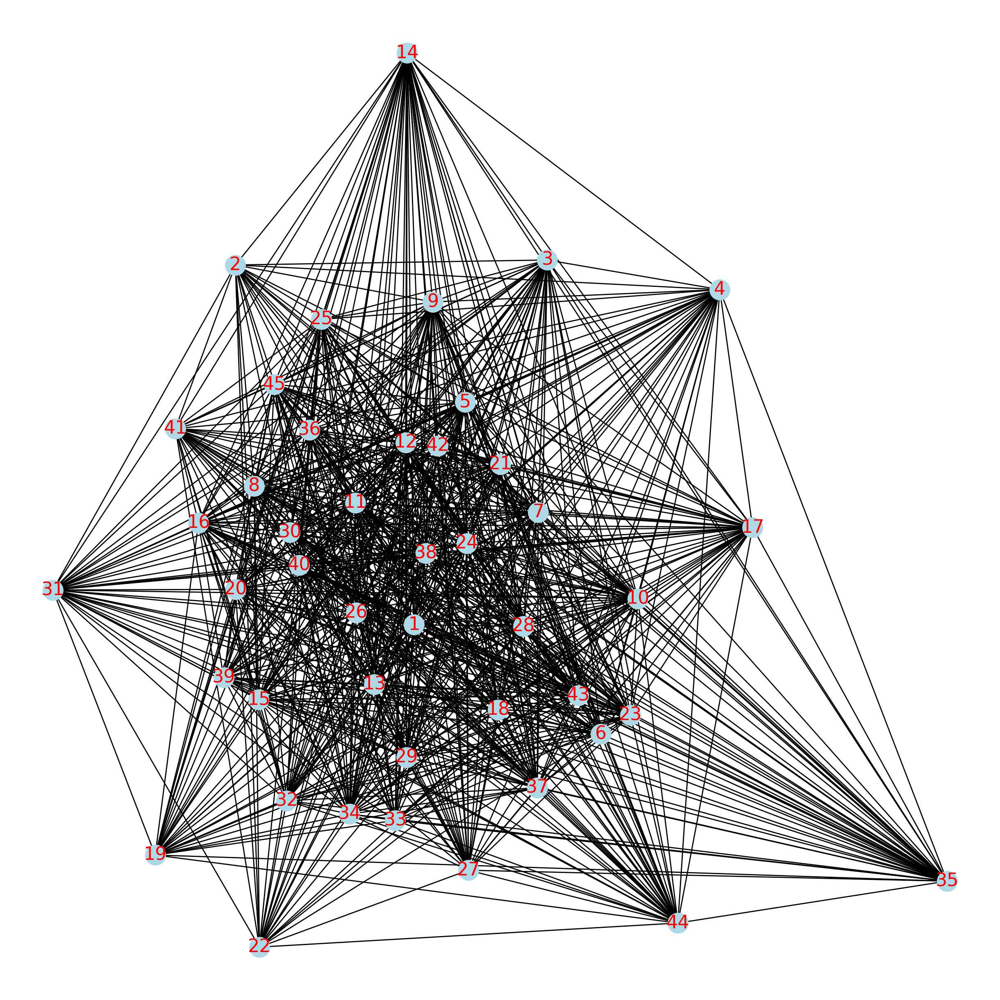

In [39]:
tf_idf_abstracts_2 = tf_idf_abstracts.rename({'aggregate demand':'1','asset pricing':'2',
       'business cycle':'3', 'central bank':'4','cross country':'5', 'developing countries':'6',
       'dsge model':'7', 'economic growth':'8','empirical evidence':'9', 'equilibrium model':'10',
       'euro area':'45','exchange rates':'11', 'financial crisis':'12','financial markets':'13', 'fiscal policy':'14',
       'foreign exchange':'15', 'gdp growth':'16', 'general equilibrium':'17',
       'global financial':'18', 'great recession':'19', 'growth model':'20',
       'growth rate':'21', 'human capital':'22', 'interest rates':'23',
       'international trade':'24', 'labor market':'25', 'labour market':'26','macroeconomic aggregates':'27',
       'macroeconomic conditions':'28', 'macroeconomic effects':'29',
       'macroeconomic fluctuations':'30','macroeconomic models':'31', 
       'macroeconomic policy':'32', 'macroeconomic shocks':'33','macroeconomic variables':'34', 
       'monetary policy':'35', 'new keynesian':'36','open economy':'37', 'price level':'38', 
       'rational expectations':'39', 'real exchange':'40','risk premium':'41',
       'steady state':'42', 'stock market':'43', 'united states':'44'}, axis='columns')
meta_matrix = tf_idf_abstracts_2.transpose().dot(tf_idf_abstracts_2)
G=nx.from_pandas_adjacency(meta_matrix)
plt.figure(figsize=(12,12), dpi=200)
nx.draw(G, pos=nx.kamada_kawai_layout(G), node_color='lightblue')
#nx.draw_networkx_nodes(G, pos=nx.kamada_kawai_layout(G), node_color="tab:red")
nx.draw_networkx_labels(G, pos=nx.kamada_kawai_layout(G), font_size=16, font_color="red")

In [40]:
centrality_time_series = []
count = 0 

# andare di anno in anno
for i in range(0, len(place_holder)-1):
    if(place_holder[i+1]-place_holder[i] > 1):
        count += 1
        meta_matrix = tf_idf_abstracts.iloc[place_holder[i]:place_holder[i+1]+1,:].transpose().dot(tf_idf_abstracts.iloc[place_holder[i]:place_holder[i+1]+1,:])
        G=nx.from_pandas_adjacency(meta_matrix)
        centrality_time_series = centrality_time_series + list(nx.degree_centrality(G).values())
        #clustering_time_series = clustering_time_series + list(nx.clustering(G).values())

In [41]:
centrality_time_series = np.reshape(centrality_time_series,(count,tf_idf_abstracts.shape[1]))
df_centrality_time_series = pd.DataFrame(data=centrality_time_series, columns=interesting_columns)
df_centrality_time_series['year'] = ""
df_centrality_time_series['year'] = interesting_years
#df_centrality_time_series.to_csv('centrality_time_series_abstracts_bigrams_international.csv')

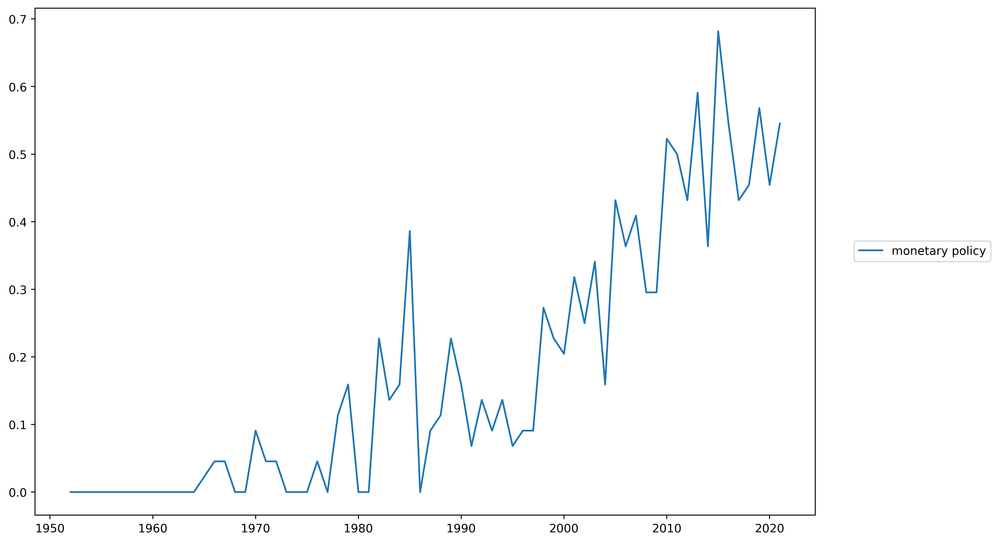

In [42]:
plt.figure(figsize=(12,8), dpi=400)
plt.plot(df_centrality_time_series['year'],df_centrality_time_series['monetary policy'], label = "monetary policy")
plt.legend(loc=(1.05,0.5))

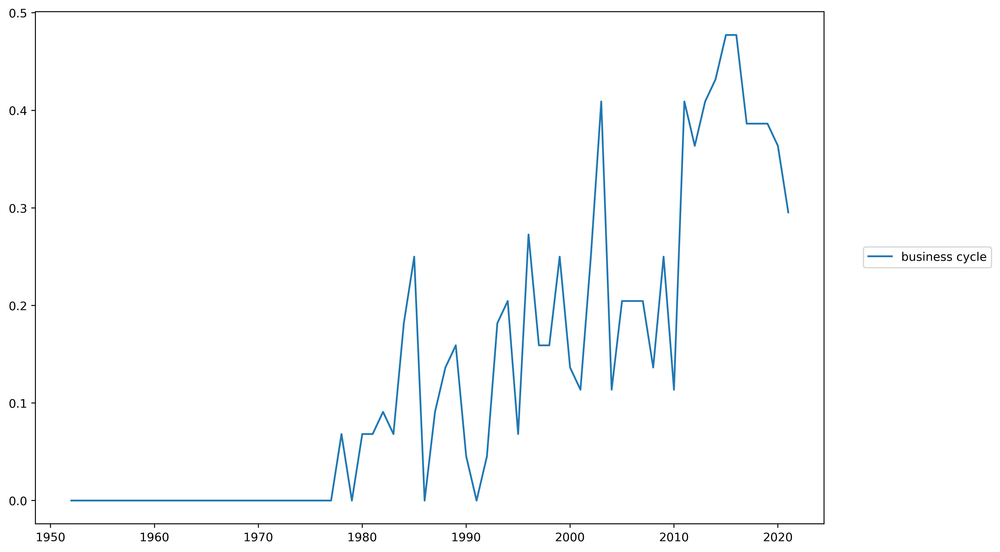

In [43]:
plt.figure(figsize=(12,8), dpi=400)
plt.plot(df_centrality_time_series['year'],df_centrality_time_series['business cycle'], label = "business cycle")
plt.legend(loc=(1.05,0.5))

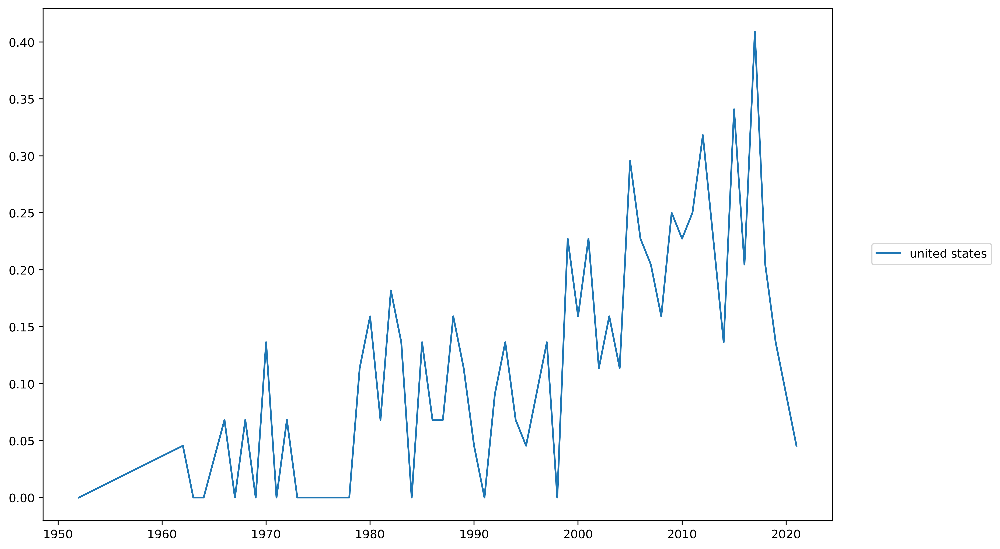

In [44]:
plt.figure(figsize=(12,8), dpi=400)
plt.plot(df_centrality_time_series['year'],df_centrality_time_series['united states'], label = "united states")
plt.legend(loc=(1.05,0.5))

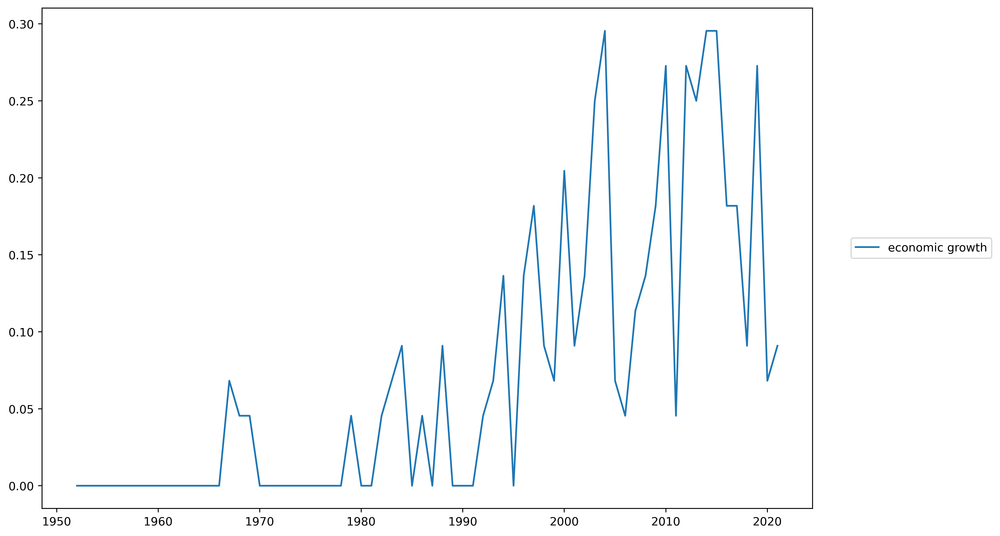

In [45]:
plt.figure(figsize=(12,8), dpi=400)
plt.plot(df_centrality_time_series['year'],df_centrality_time_series['economic growth'], label = "economic growth")
plt.legend(loc=(1.05,0.5))

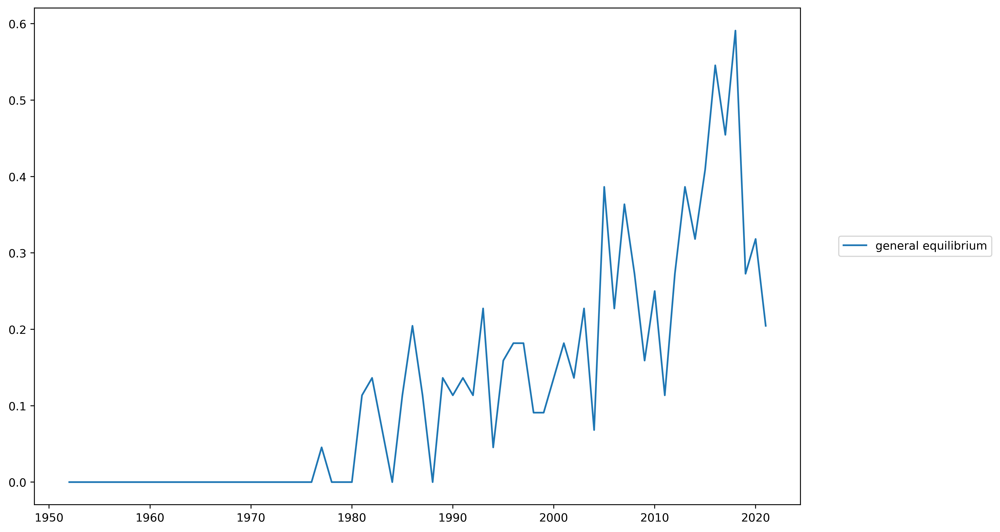

In [46]:
plt.figure(figsize=(12,8), dpi=400)
plt.plot(df_centrality_time_series['year'],df_centrality_time_series['general equilibrium'], label = "general equilibrium")
plt.legend(loc=(1.05,0.5))

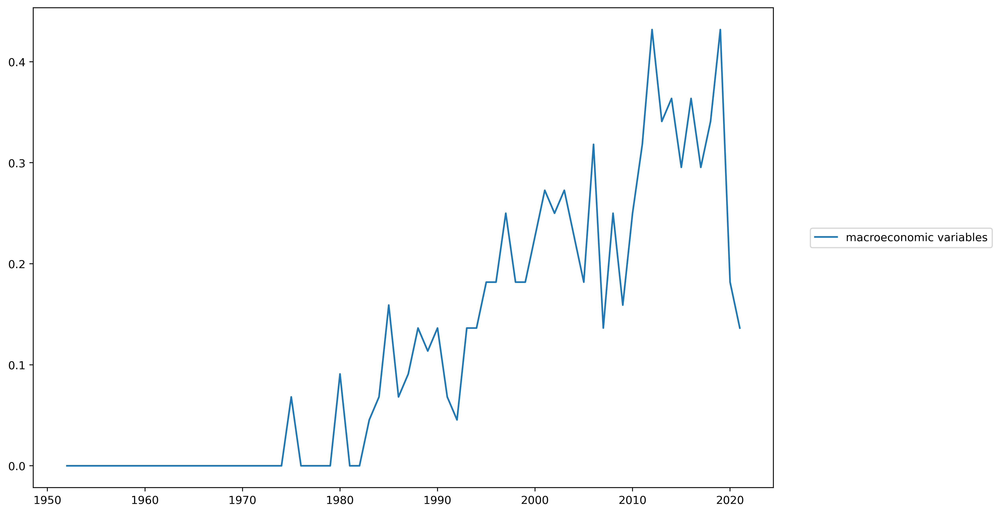

In [47]:
plt.figure(figsize=(12,8), dpi=400)
plt.plot(df_centrality_time_series['year'],df_centrality_time_series['macroeconomic variables'], label = "macroeconomic variables")
plt.legend(loc=(1.05,0.5))

In [48]:
df.to_csv('macroeconomic_cleaned.csv')

<ipython-input-49-a24d40afe3e2>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(12,8), dpi=400)


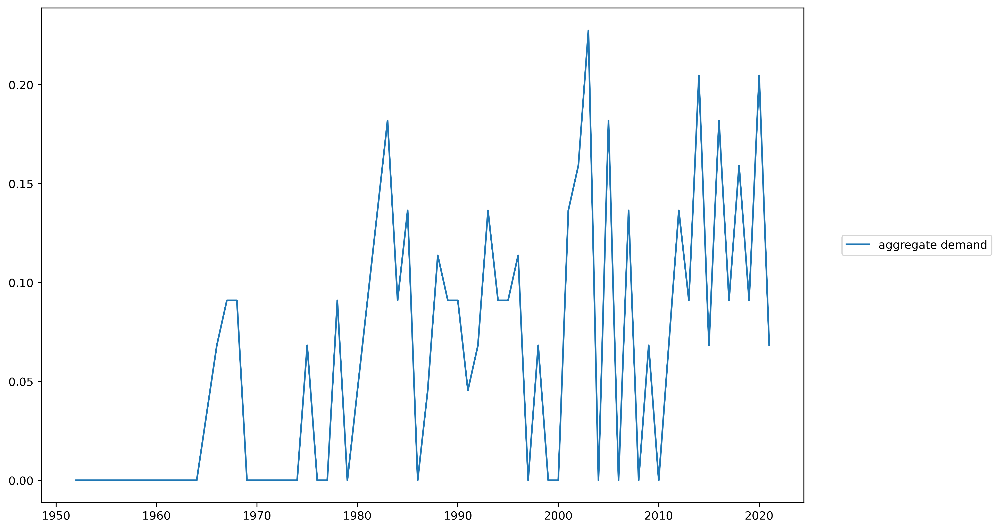

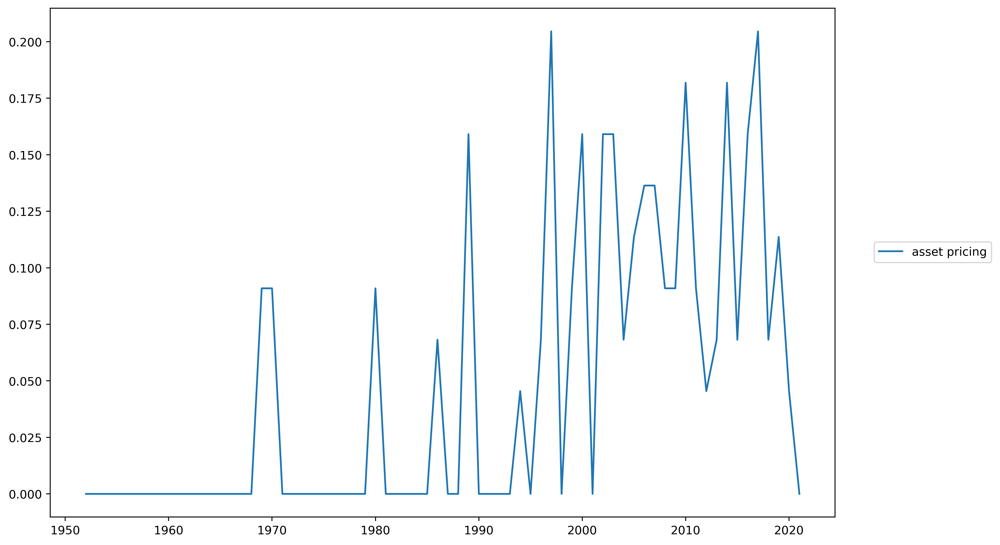

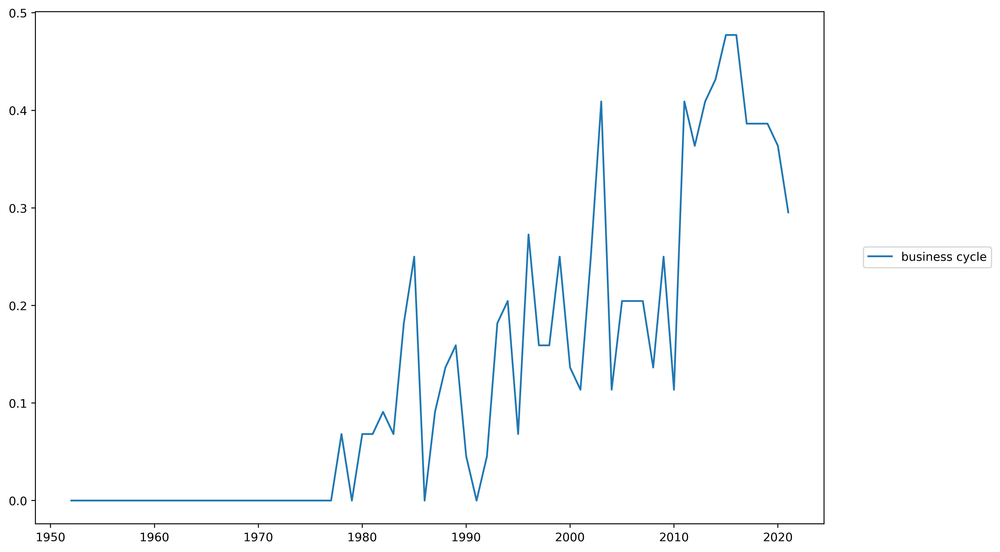

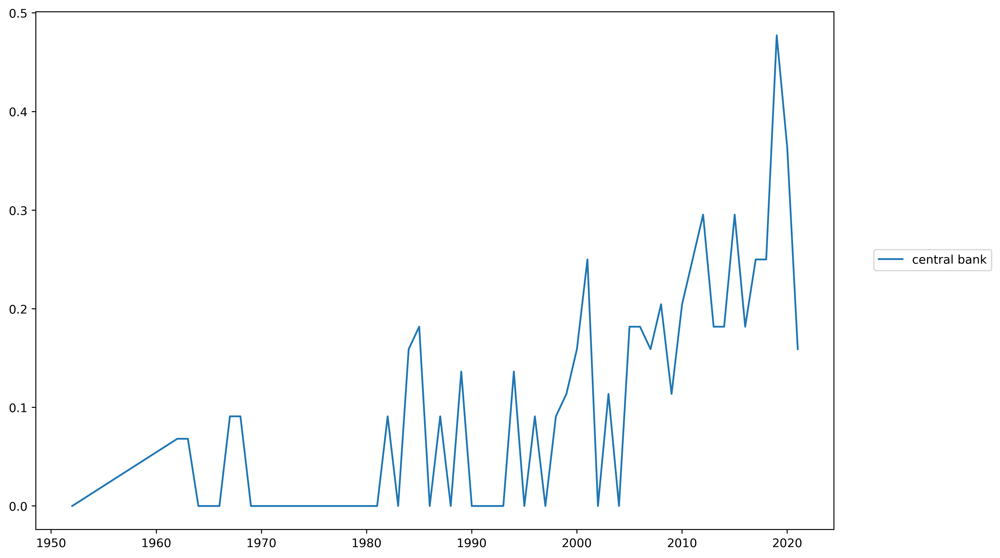

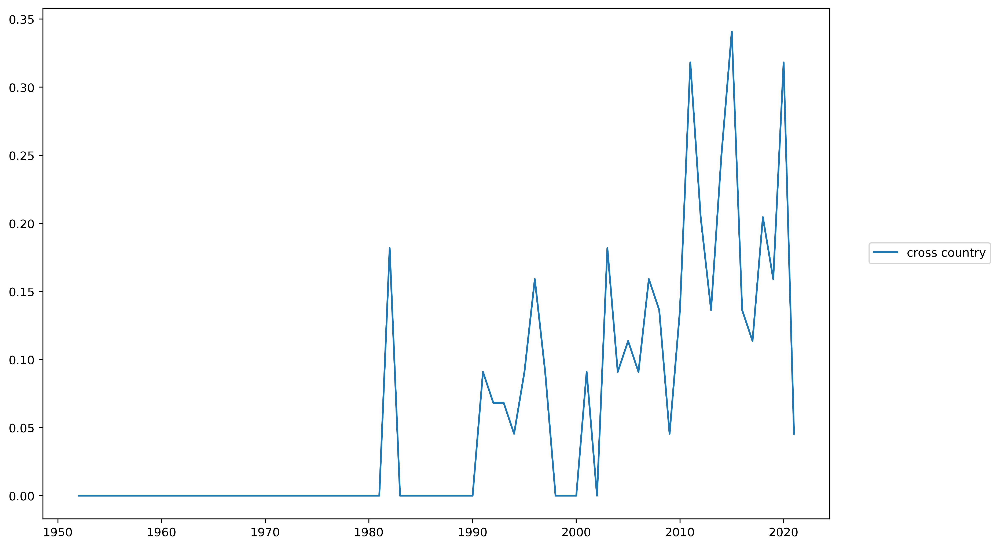

...

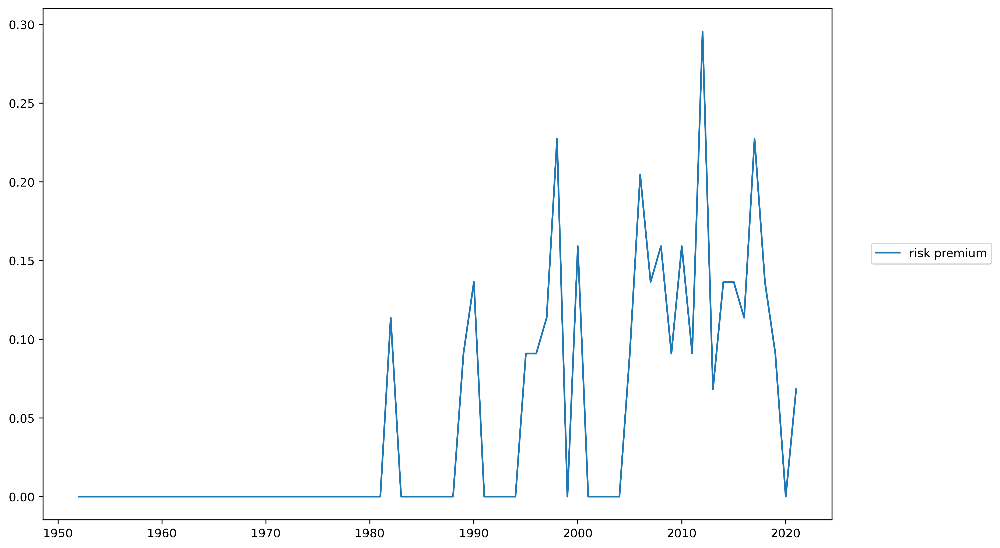

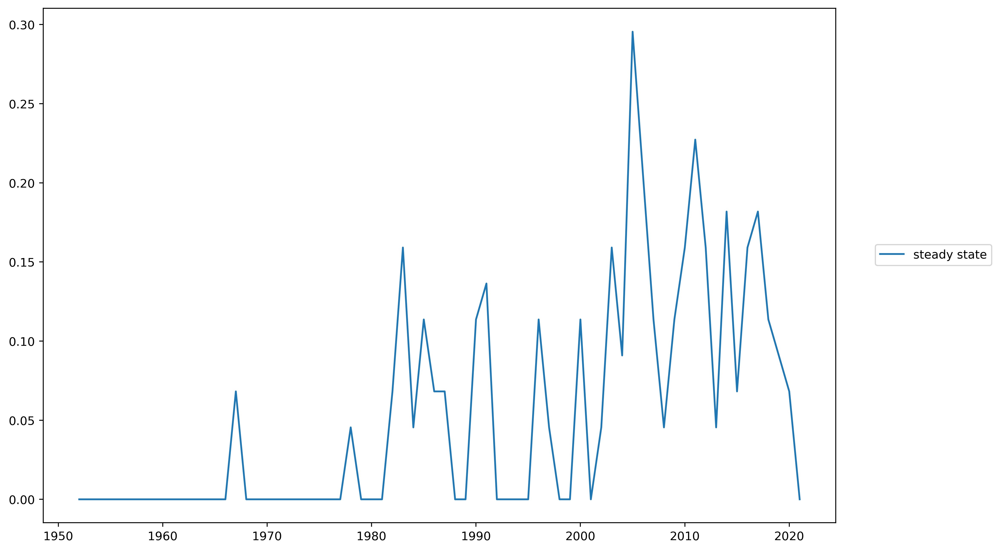

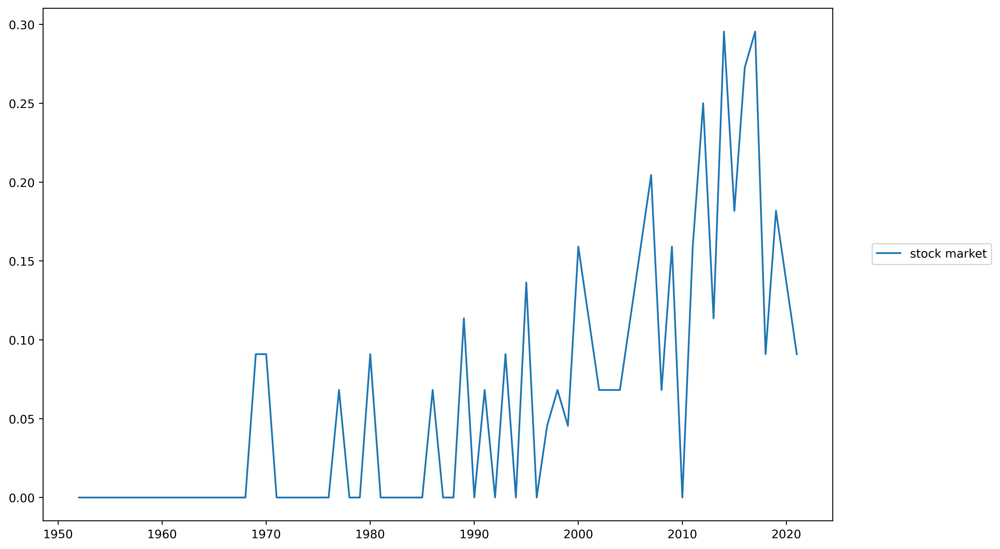

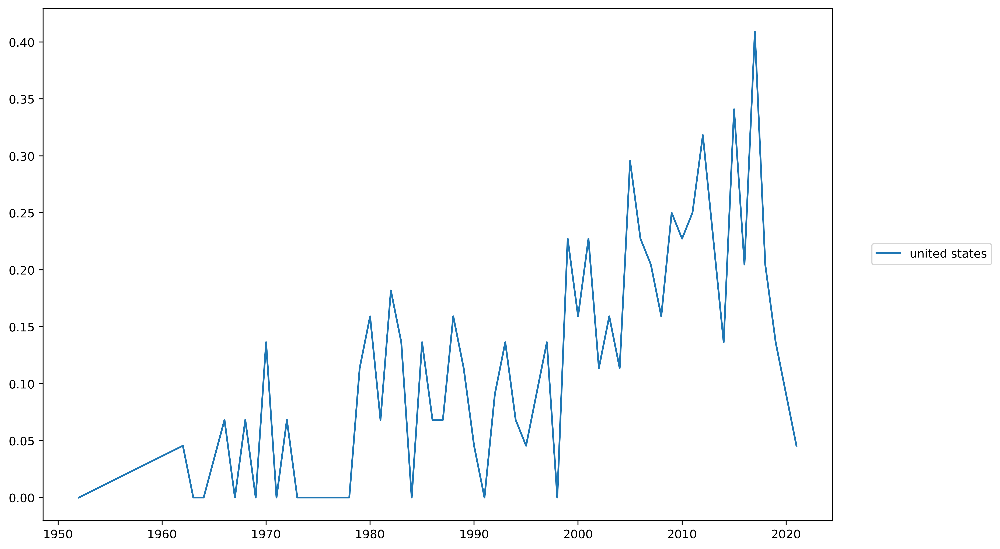

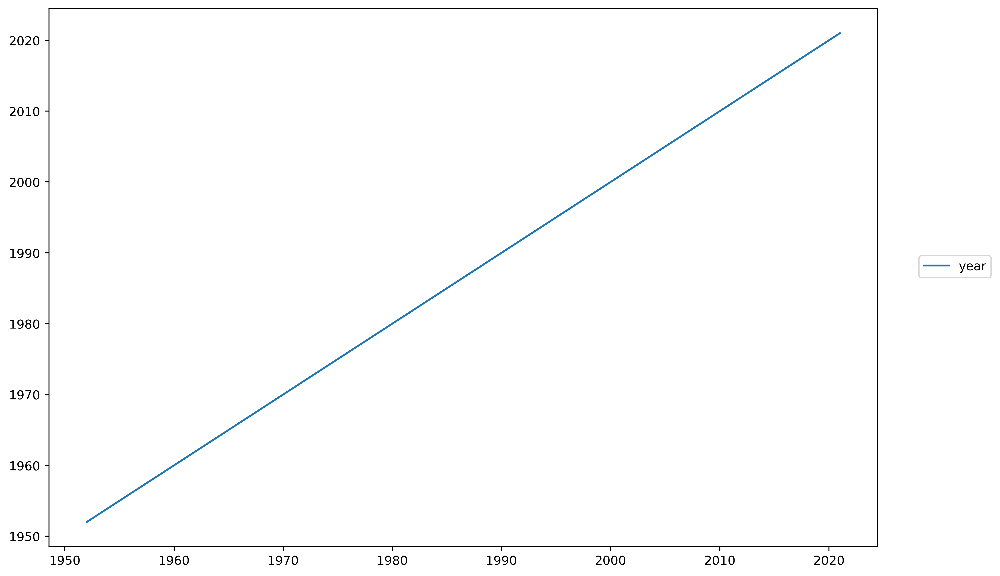

In [49]:
for feature in df_centrality_time_series:
    plt.figure(figsize=(12,8), dpi=400)
    plt.plot(df_centrality_time_series['year'],df_centrality_time_series[feature], label = feature)
    plt.legend(loc=(1.05,0.5))